In [1]:
import numpy as np
import pandas as pd
import os 
import matplotlib.pyplot as plt
import umap
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans

from dredFISH.Utils import __init__plots
from dredFISH.Utils import basicu
from dredFISH.Utils import miscu

In [2]:
# pth_dat = '/bigstore/GeneralStorage/fangming/projects/visctx/data_dump/easifish_aug1'
pth_dat = '/bigstore/GeneralStorage/fangming/projects/visctx/data_dump/testfull-aug25_epsilon1/'
!ls $pth_dat

bad_roi_list.npy  roi.csv	 spotcount_intn.csv
roi_all.csv	  spotcount.csv  spotcount_merged.csv


In [3]:
gene_names = {
    'r1_c0': 'Sorcs3',
    'r1_c1': 'Kcnq5',
    'r1_c2': 'Chrm2',
    'r1_c4': 'Adamts2',
    
    'r2_c0': 'Kcnip3',
    'r2_c1': 'Rorb',
    'r2_c2': 'Cdh13',
    'r2_c4': 'Cntn5',
}

ftrs_order = [
    'r1_c4', # a 
    'r2_c2', # a
    'r2_c4', # a, L4
    
    'r1_c0', # b
    
    'r1_c1', # c
    
    'r1_c2', # c, L4
    
    'r2_c1', # L4
    'r2_c0', # L4

]
genes_order = [gene_names[ftr] for ftr in ftrs_order]
genes_order

['Adamts2', 'Cdh13', 'Cntn5', 'Sorcs3', 'Kcnq5', 'Chrm2', 'Rorb', 'Kcnip3']

In [4]:
# f_meta2 = os.path.join(pth_dat, 'roi_all.csv')
f_meta = os.path.join(pth_dat, 'roi.csv')
f_ftrs = os.path.join(pth_dat, 'spotcount_merged.csv')

# f_badroi = os.path.join(pth_dat, 'bad_roi_list.npy')
# badroi = np.load(f_badroi)
# badroi.shape, badroi[:5]

In [5]:
meta = pd.read_csv(f_meta, index_col=0)
ftrs = pd.read_csv(f_ftrs, index_col=0)
df = ftrs.join(meta).dropna()
ftrs_cols = ftrs.columns.values
print(meta.shape, ftrs.shape, df.shape)

(12867, 4) (12867, 8) (12867, 12)


In [6]:
max_x, max_y, max_z = df[['x', 'y', 'z']].describe().loc['max']
min_x, min_y, min_z = df[['x', 'y', 'z']].describe().loc['min']
df['to_edge'] = np.minimum(
    np.minimum(df['x']-min_x, max_x-df['x']), 
    np.minimum(df['y']-min_y, max_y-df['y']), 
    np.minimum(df['z']-min_z, max_z-df['z']),
)

for col in ftrs_cols:
    val = df[col].values
    print(np.min(val), np.max(val), np.sum(val>0))

0.0 245.4719243062117 9097
0.0 593.2748580003694 12204
0.0 183.0704151334532 6347
0.0 46.0 5127
0.0 91.0 6015
0.0 177.0 10366
0.0 78.0 4131
0.0 32.0 3912


In [7]:
# remove outliers
conds = [
    df['area'] > 500,
    df['x'] > min_x + 10,
    df['x'] < max_x - 10,
    
    df['y'] > min_y + 10,
    df['y'] < max_y - 10,
    
    df['z'] > min_z + 10,
    df['z'] < max_z - 10,
]
cond_all = np.ones(len(df)) > 0
for cond in conds:
    cond_all = np.logical_and(cond_all, cond)
    print(cond_all.sum())
print(len(df), cond_all.sum())

dfnew = df[cond_all].copy()

# size
med_size = dfnew['area'].median()
print(med_size)
size_factor = dfnew['area']/med_size

# norm by size
mat_raw = dfnew[ftrs_cols].values
dfnew[ftrs_cols] = dfnew[ftrs_cols].divide(size_factor, axis=0)
mat_sizenorm = dfnew[ftrs_cols].values

# log2+1 norm
normed_ftrs_cols = np.char.add(ftrs_cols.astype(str) ,'_log2')
dfnew[normed_ftrs_cols] = np.log2(dfnew[ftrs_cols]+1)
mat_log2norm = dfnew[normed_ftrs_cols].values

# zscore
mat_zscore = (mat_log2norm - np.mean(mat_log2norm, axis=0))/np.std(mat_log2norm, axis=0)
mat_zscore

11880
11606
11510
11496
11496
11448
11437
12867 11437
1168.22244


array([[ 0.11876913, -0.39729241, -0.91451832, ..., -0.71657458,
         1.08825602,  0.42520416],
       [ 0.65319846,  0.66308029, -0.91451832, ...,  0.29183876,
        -0.6581646 , -0.6267425 ],
       [-0.28717231, -0.13057614, -0.91451832, ..., -0.11981525,
        -0.6581646 ,  0.54449069],
       ...,
       [ 3.75442448,  2.89561846,  6.51173304, ...,  0.97936118,
         1.21600419,  2.18797964],
       [-1.31943373, -0.1351249 ,  1.82344683, ...,  0.21925619,
         1.25193424, -0.6267425 ],
       [-1.31943373, -0.45127968, -0.91451832, ..., -0.69412061,
        -0.6581646 , -0.6267425 ]])

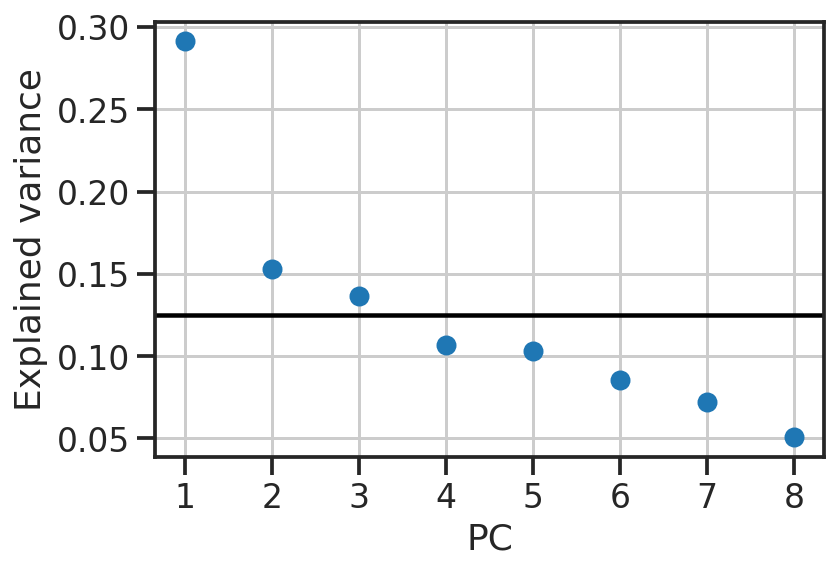

In [8]:
# PCAs
n_pc = 8
idx_pcs = np.arange(1, n_pc+1)


pca = PCA(n_components=8)
pcs = pca.fit_transform(mat_zscore)
plt.plot(idx_pcs, pca.explained_variance_ratio_, 'o')
plt.xticks(idx_pcs)
plt.axhline(1/n_pc, color='k')
plt.xlabel('PC')
plt.ylabel('Explained variance')

for i in idx_pcs:
    dfnew[f'PC{i}'] = pcs[:,i-1]

In [10]:
# # UMAPs
# Zspace = umap.UMAP(n_components=2).fit_transform(pcs)
# dfnew['umap_x'] = Zspace[:,0]
# dfnew['umap_y'] = Zspace[:,1]

In [11]:
# # UMAPs more
# nns = [30, 60, 120, 240, 480]
# for nn in nns:
#     Zspace = umap.UMAP(n_components=2, n_neighbors=nn).fit_transform(pcs)
#     dfnew[f'umap_x_nn{nn}'] = Zspace[:,0]
#     dfnew[f'umap_y_nn{nn}'] = Zspace[:,1]

In [12]:
# # clsts
# numclsts = [2, 5, 10]
# for k in numclsts: 
#     model = KMeans(n_clusters=k)
#     clsts = model.fit_predict(pcs)
#     dfnew[f'clsts_k{k}'] = np.char.add("c", clsts.astype(str))

In [13]:
# # clsts
# G = miscu.build_feature_graph_knnlite(pcs, k=15, metric='euclidean')
# rs = [0.01, 0.02, 0.05, 0.1, 1]
# for r in rs:
#     clsts = miscu.leiden(G, dfnew.index.values, resolution=r) 
#     dfnew[f'clsts_r{r}'] = np.char.add("c", np.array(clsts).astype(str))

Text(0.5, 0, 'size/median_size')

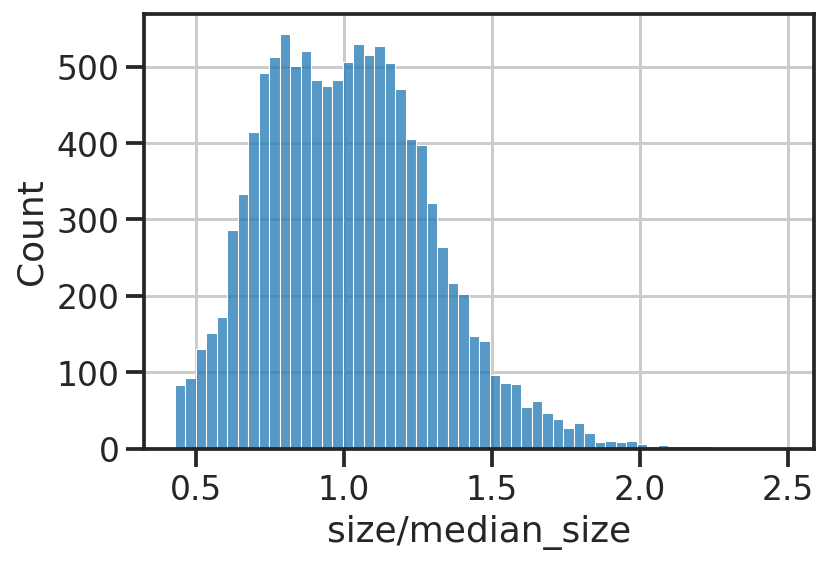

In [14]:
sns.histplot(size_factor)
plt.xlabel('size/median_size')

# check basics
- unit (um?) 2x expanded?
- y: dorsal ventral (layers in cortex)
- x: lateral medial?
- z:

In [15]:
x = df['x'].values
y = df['y'].values
z = df['z'].values

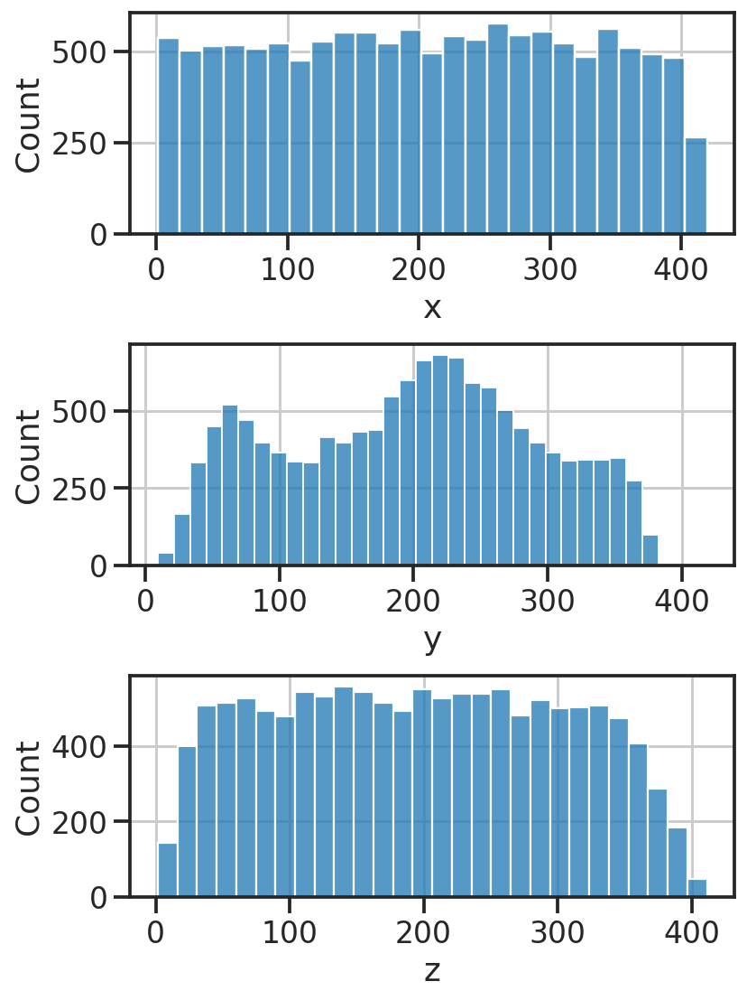

Text(0.5, 0, 'area')

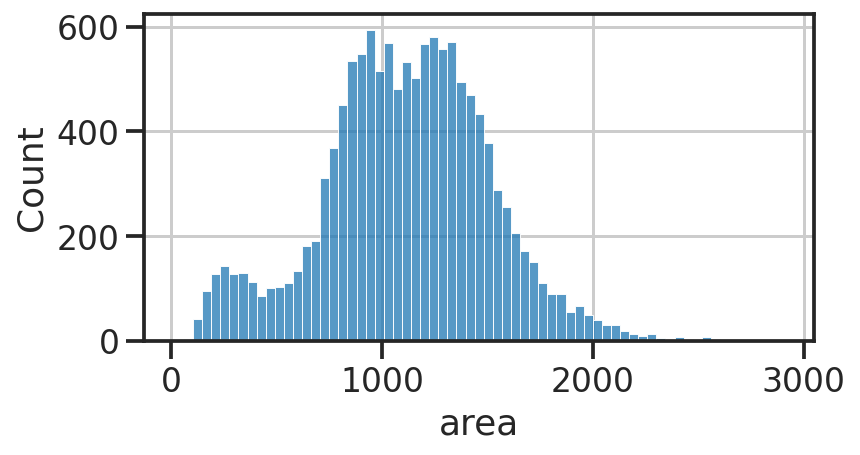

In [16]:
fig, axs = plt.subplots(3, 1, figsize=(1*6, 3*3))
ax = axs[0]
sns.histplot(x, ax=ax)
ax.set_xlabel('x')

ax = axs[1]
sns.histplot(y, ax=ax)
ax.set_xlabel('y')

ax = axs[2]
sns.histplot(z, ax=ax)
ax.set_xlabel('z')

fig.subplots_adjust(hspace=0.5)
plt.show()

fig, ax = plt.subplots(1, 1, figsize=(1*6, 1*3))
sns.histplot(df['area'].values, ax=ax)
ax.set_xlabel('area')

Text(0.5, 0, 'Genes')

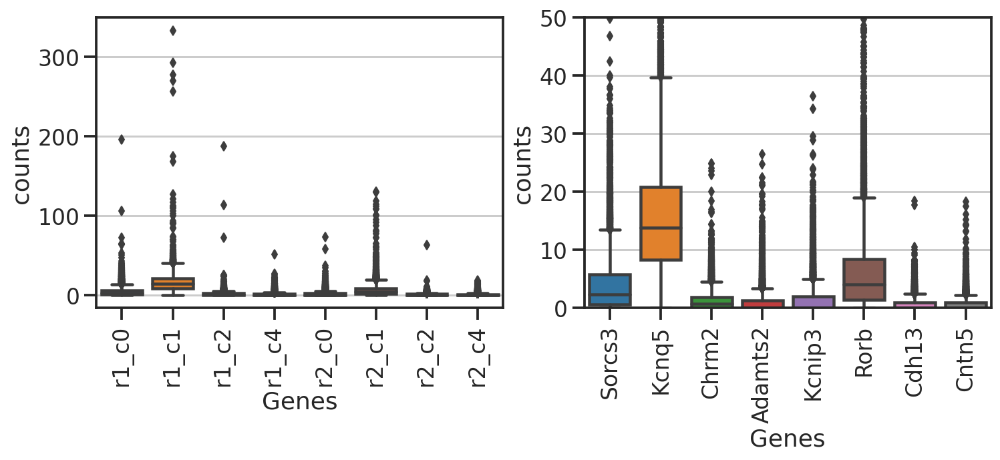

In [17]:
fig, axs = plt.subplots(1, 2, figsize=(6*2,4))
ax = axs[0]
sns.boxplot(data=dfnew[ftrs_cols], ax=ax)
ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
ax.set_ylabel('counts')
ax.set_xlabel('Genes')

ax = axs[1]
sns.boxplot(data=dfnew[ftrs_cols], ax=ax)
ax.set_xticklabels([gene_names[ftr_col] for ftr_col in ftrs_cols], rotation=90)
ax.set_ylim([0,50])
ax.set_ylabel('counts')
ax.set_xlabel('Genes')

In [18]:
# n = len(nns)
# fig, axs = plt.subplots(1, n, figsize=(n*5,1*5))
# for nn, ax in zip(nns, axs.flat):
#     sns.scatterplot(data=dfnew, x=f'umap_x_nn{nn}', y=f'umap_y_nn{nn}', #hue=col, 
#                     s=1, edgecolor='none', palette='coolwarm', 
#                     legend=False,
#                     ax=ax, 
#                     )

NameError: name 'nns' is not defined

In [20]:
# fig, axs = plt.subplots(2, 4, figsize=(4*4,4*2), sharex=True, sharey=True)
# for col, ax in zip(normed_ftrs_cols, axs.flat):
#     vmax = np.percentile(dfnew[col].values, 80)
#     g = sns.scatterplot(data=dfnew, x='umap_x_nn120', y='umap_y_nn120', hue=col, 
#                         s=1, edgecolor='none', palette='coolwarm', 
#                         legend=False,
#                         vmax=vmax,
#                         ax=ax, 
#                        )
#     ax.set_title(gene_names[col.replace('_log2', '')])
#     ax.axis('off')
# plt.show()

In [21]:
# for k in numclsts:
#     hue = f'clsts_k{k}' 

#     fig, axs = plt.subplots(1, 4, figsize=(7*4,6*1))
#     ax = axs[0]
#     sns.scatterplot(data=dfnew, x='umap_x_nn120', y='umap_y_nn120', 
#                     hue=hue, s=4, edgecolor='none', cmap='coolwarm', ax=ax)
#     ax.legend(bbox_to_anchor=(0, -0.1), loc='upper left')

#     ax = axs[1]
#     sns.scatterplot(data=dfnew, x='x', y='y', 
#                     hue=hue, s=4, edgecolor='none', cmap='coolwarm', ax=ax)
#     ax.legend(bbox_to_anchor=(0, -0.1), loc='upper left')

#     ax = axs[2]
#     sns.scatterplot(data=dfnew, x='z', y='y', 
#                     hue=hue, s=4, edgecolor='none', cmap='coolwarm', ax=ax)
#     ax.legend(bbox_to_anchor=(0, -0.1), loc='upper left')

#     ax = axs[3]
#     sns.scatterplot(data=dfnew, x='x', y='z', 
#                     hue=hue, s=4, edgecolor='none', cmap='coolwarm', ax=ax)
#     ax.legend(bbox_to_anchor=(0, -0.1), loc='upper left')

#     plt.show()

In [22]:
# for r in rs:
#     hue = f'clsts_r{r}' 
#     hue_order = np.unique(dfnew[hue])
#     ncat = len(hue_order)
#     if ncat > 5:
#         cmap = 'Paired'
#     else:
#         cmap = 'tab10'
#     palette = {clst: clr for clst, clr in zip(hue_order, sns.color_palette(cmap, ncat))}

#     fig, axs = plt.subplots(1, 4, figsize=(7*4,6*1))
#     ax = axs[0]
#     sns.scatterplot(data=dfnew, x='umap_x_nn120', y='umap_y_nn120', 
#                     hue=hue, hue_order=hue_order, palette=palette,
#                     s=4, edgecolor='none', ax=ax)
#     ax.legend(bbox_to_anchor=(0, -0.1), loc='upper left')

#     ax = axs[1]
#     sns.scatterplot(data=dfnew, x='x', y='y', 
#                     hue=hue, hue_order=hue_order, palette=palette,
#                     s=4, edgecolor='none', ax=ax)
#     ax.legend(bbox_to_anchor=(0, -0.1), loc='upper left')

#     ax = axs[2]
#     sns.scatterplot(data=dfnew, x='z', y='y', 
#                     hue=hue, hue_order=hue_order, palette=palette,
#                     s=4, edgecolor='none', ax=ax)
#     ax.legend(bbox_to_anchor=(0, -0.1), loc='upper left')

#     ax = axs[3]
#     sns.scatterplot(data=dfnew, x='x', y='z', 
#                     hue=hue, hue_order=hue_order, palette=palette,
#                     s=4, edgecolor='none', ax=ax)
#     ax.legend(bbox_to_anchor=(0, -0.1), loc='upper left')

#     plt.show()

/tmp/ipykernel_2365/1614015042.py:24: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  fig.colorbar(g, ax=ax, label='log2 normed')


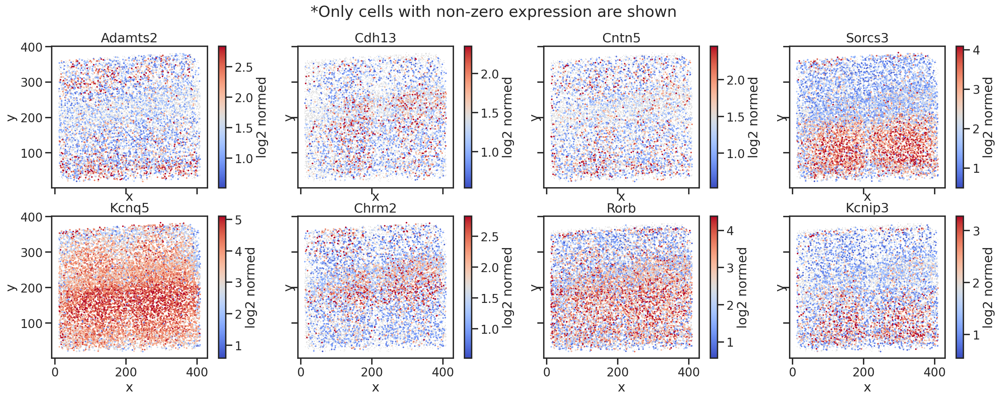

In [23]:
sp_x, sp_y = 'x', 'y'
fig, axs = plt.subplots(2,4,figsize=(6*4,4*2), sharey=True, sharex=True)
for i, (col, ax) in enumerate(zip(ftrs_order, axs.flat)):
    col = col+'_log2'
    x = dfnew[sp_x].values
    y = dfnew[sp_y].values
    c = dfnew[col].values
    cond = c>0
    ax.scatter(x[~cond], y[~cond], s=1, edgecolor='none', color='lightgray')
    
    x = x[cond]
    y = y[cond]
    c = c[cond]
    vmax=np.percentile(c, 95)
    
    
    g = ax.scatter(x, y, c=c, s=5, edgecolor='none', cmap='coolwarm', vmax=vmax)
    ax.set_title(gene_names[col.replace('_log2', '')])
    ax.set_xlabel(sp_x)
    ax.set_ylabel(sp_y)
    ax.set_aspect('equal')
    ax.grid(False)
    
    fig.colorbar(g, ax=ax, label='log2 normed')
fig.suptitle('*Only cells with non-zero expression are shown')
fig.subplots_adjust(hspace=0.2, wspace=0.1)

/tmp/ipykernel_2365/760207231.py:23: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  fig.colorbar(g, ax=ax, label='Normed counts')


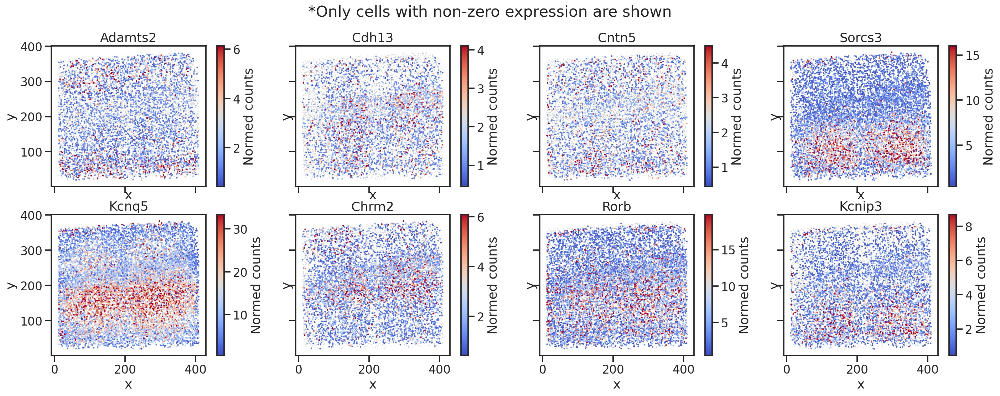

In [27]:
sp_x, sp_y = 'x', 'y'
fig, axs = plt.subplots(2,4,figsize=(6*4,4*2), sharey=True, sharex=True)
for i, (col, ax) in enumerate(zip(ftrs_order, axs.flat)):
    x = dfnew[sp_x].values
    y = dfnew[sp_y].values
    c = dfnew[col].values
    cond = c>0
    ax.scatter(x[~cond], y[~cond], s=1, edgecolor='none', color='lightgray')
    
    x = x[cond]
    y = y[cond]
    c = c[cond]
    vmax=np.percentile(c, 95)
    
    
    g = ax.scatter(x, y, c=c, s=5, edgecolor='none', cmap='coolwarm', vmax=vmax)
    ax.set_title(gene_names[col.replace('_log2', '')])
    ax.set_xlabel(sp_x)
    ax.set_ylabel(sp_y)
    ax.set_aspect('equal')
    ax.grid(False)
    
    fig.colorbar(g, ax=ax, label='Normed counts')
fig.suptitle('*Only cells with non-zero expression are shown')
fig.subplots_adjust(hspace=0.2, wspace=0.1)

/tmp/ipykernel_2365/544810237.py:16: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  fig.colorbar(g, ax=ax, label='Normed counts')


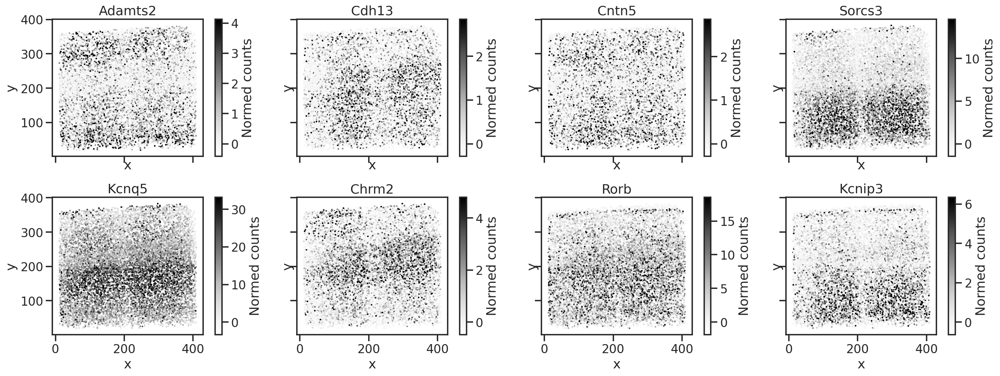

In [51]:
sp_x, sp_y = 'x', 'y'
fig, axs = plt.subplots(2,4,figsize=(6*4,4*2), sharey=True, sharex=True)
for i, (col, ax) in enumerate(zip(ftrs_order, axs.flat)):
    x = dfnew[sp_x].values
    y = dfnew[sp_y].values
    c = dfnew[col].values
    vmax=np.percentile(c, 95)
    
    ax.grid(False)
    g = ax.scatter(x, y, c=c, s=5, edgecolor='none', cmap='Greys', vmax=vmax, vmin=-0.1*vmax)
    ax.set_title(gene_names[col.replace('_log2', '')])
    ax.set_xlabel(sp_x)
    ax.set_ylabel(sp_y)
    ax.set_aspect('equal')
    
    fig.colorbar(g, ax=ax, label='Normed counts')
fig.subplots_adjust(hspace=0.3, wspace=0.02)

/tmp/ipykernel_2365/2069300378.py:17: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  fig.colorbar(g, ax=ax, label='log2 normed counts')


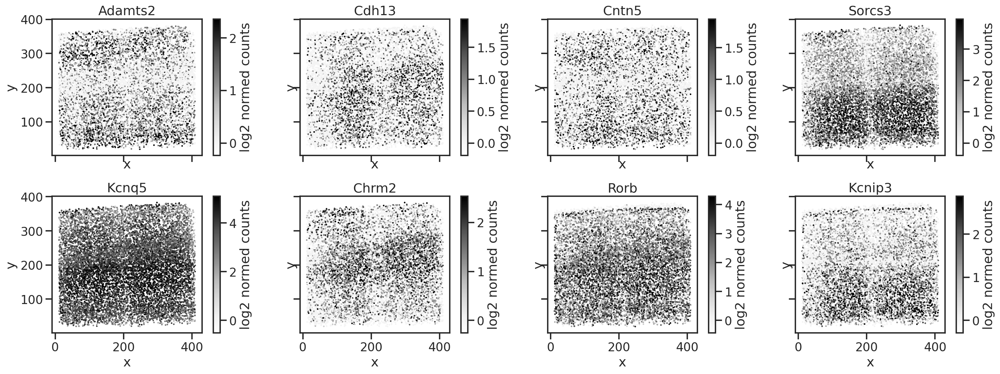

In [48]:
sp_x, sp_y = 'x', 'y'
fig, axs = plt.subplots(2,4,figsize=(6*4,4*2), sharey=True, sharex=True)
for i, (col, ax) in enumerate(zip(ftrs_order, axs.flat)):
    col = col+'_log2'
    x = dfnew[sp_x].values
    y = dfnew[sp_y].values
    c = dfnew[col].values
    vmax=np.percentile(c, 95)
    
    g = ax.scatter(x, y, c=c, s=5, edgecolor='none', cmap='Greys', vmax=vmax, vmin=-0.1*vmax)
    ax.set_title(gene_names[col.replace('_log2', '')])
    ax.set_xlabel(sp_x)
    ax.set_ylabel(sp_y)
    ax.set_aspect('equal')
    ax.grid(False)
    
    fig.colorbar(g, ax=ax, label='log2 normed counts')
fig.subplots_adjust(hspace=0.3, wspace=0.1)

/tmp/ipykernel_2365/396657425.py:19: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  fig.colorbar(g, ax=ax, label='Normed counts')


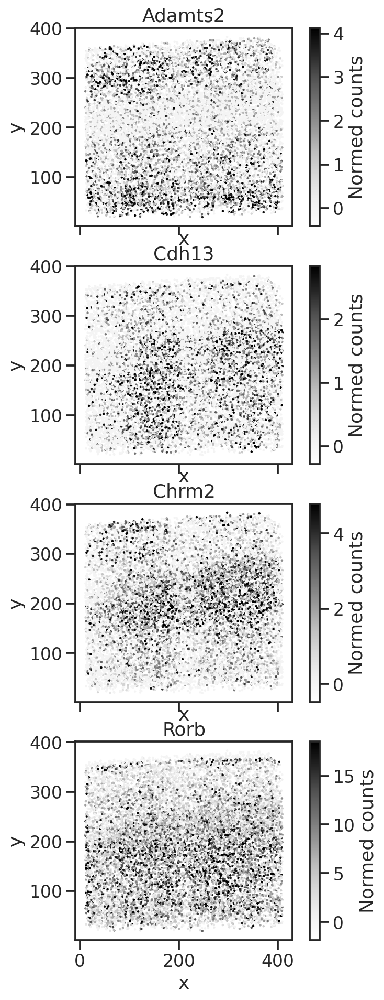

In [57]:
dfnewplot = dfnew.copy().rename(columns=gene_names)
ftrs_grant = ['Adamts2', 'Cdh13', 'Chrm2', 'Rorb']

sp_x, sp_y = 'x', 'y'
fig, axs = plt.subplots(4,1,figsize=(6*1,4*4), sharey=True, sharex=True)
for i, (col, ax) in enumerate(zip(ftrs_grant, axs.flat)):
    x = dfnewplot[sp_x].values
    y = dfnewplot[sp_y].values
    c = dfnewplot[col].values
    vmax=np.percentile(c, 95)
    
    ax.grid(False)
    g = ax.scatter(x, y, c=c, s=5, edgecolor='none', cmap='Greys', vmax=vmax, vmin=-0.1*vmax)
    ax.set_title(col)
    ax.set_xlabel(sp_x)
    ax.set_ylabel(sp_y)
    ax.set_aspect('equal')
    
    fig.colorbar(g, ax=ax, label='Normed counts')
fig.subplots_adjust(hspace=0.2, wspace=0.02)

In [92]:
# binary analysis
ftrs_cols_binary = np.char.add(ftrs_cols.astype(str), "_b")
print(ftrs_cols_binary)

dfnew[ftrs_cols_binary] = (dfnew[ftrs_cols] > 1e-5).astype(int)

ybins = np.linspace(0,400,100)
dfnew['ybin'] = pd.cut(dfnew['y'], bins=ybins)

xbins = np.linspace(0,400,100)
dfnew['xbin'] = pd.cut(dfnew['x'], bins=xbins)

zbins = np.linspace(0,400,100)
dfnew['zbin'] = pd.cut(dfnew['z'], bins=zbins)

bins_zb = np.linspace(0,400,9).astype(int)
print(bins_zb)
dfnew['bins_zb'] = pd.cut(dfnew['z'], bins=bins_zb)

bins_zb_4p = np.linspace(0,400,5).astype(int)
print(bins_zb_4p)
dfnew['bins_zb_4p'] = pd.cut(dfnew['z'], bins=bins_zb_4p)

bins_xb = np.linspace(0,400,9).astype(int)
print(bins_zb)
dfnew['bins_xb'] = pd.cut(dfnew['x'], bins=bins_xb)


['r1_c0_b' 'r1_c1_b' 'r1_c2_b' 'r1_c4_b' 'r2_c0_b' 'r2_c1_b' 'r2_c2_b'
 'r2_c4_b']
[  0  50 100 150 200 250 300 350 400]
[  0 100 200 300 400]
[  0  50 100 150 200 250 300 350 400]


In [65]:
dfmean = dfnew.groupby(['ybin']).mean()[ftrs_cols_binary]
dfmean

,r1_c0_b,r1_c1_b,r1_c2_b,r1_c4_b,r2_c0_b,r2_c1_b,r2_c2_b,r2_c4_b
ybin,,,,,,,,
"(0.0, 4.04]",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
"(4.04, 8.081]",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
"(8.081, 12.121]",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
"(12.121, 16.162]",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
"(16.162, 20.202]",1.0,1.0,0.50,1.00,0.5,1.0,0.00,1.0
...,...,...,...,...,...,...,...,...
"(379.798, 383.838]",1.0,1.0,0.75,0.25,0.0,0.0,0.25,0.0
"(383.838, 387.879]",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
"(387.879, 391.919]",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


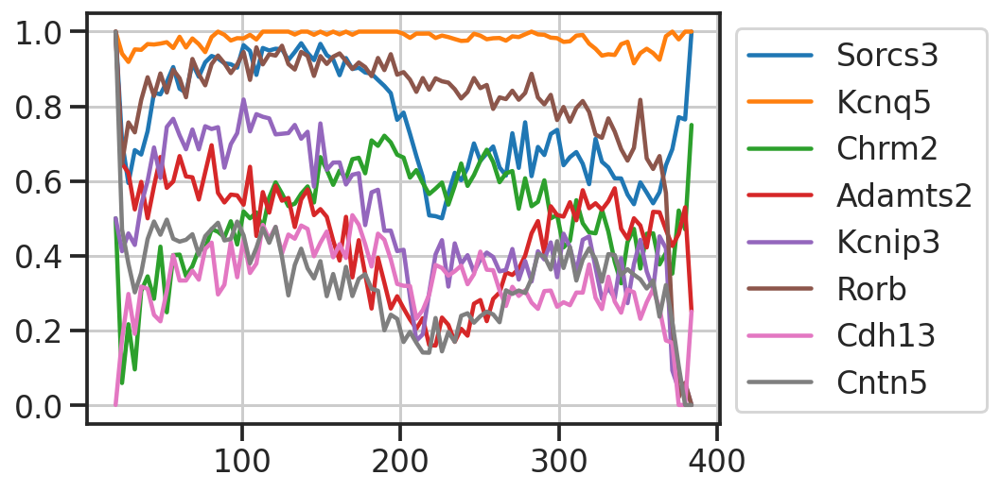

In [66]:
for col in dfmean:
    plt.plot(ybins[1:], dfmean[col].values, label=gene_names[col.replace('_b', '')])
plt.legend(bbox_to_anchor=(1,1))
plt.show()

# z-sectioning visuals
- bin into zbin
- plot for each zbin

In [67]:
dfnew.columns.tolist()

['r1_c0',
 'r1_c1',
 'r1_c2',
 'r1_c4',
 'r2_c0',
 'r2_c1',
 'r2_c2',
 'r2_c4',
 'z',
 'y',
 'x',
 'area',
 'to_edge',
 'r1_c0_log2',
 'r1_c1_log2',
 'r1_c2_log2',
 'r1_c4_log2',
 'r2_c0_log2',
 'r2_c1_log2',
 'r2_c2_log2',
 'r2_c4_log2',
 'PC1',
 'PC2',
 'PC3',
 'PC4',
 'PC5',
 'PC6',
 'PC7',
 'PC8',
 'r1_c0_b',
 'r1_c1_b',
 'r1_c2_b',
 'r1_c4_b',
 'r2_c0_b',
 'r2_c1_b',
 'r2_c2_b',
 'r2_c4_b',
 'ybin',
 'xbin',
 'zbin',
 'bins_zb',
 'bins_xb']

In [68]:
def gen_palette(dfnew, col):
    # set global colorbar
    hue_order = np.unique(dfnew[col]) 
    ncat = len(hue_order)
    if ncat > 5:
        cmap = 'Paired'
    else:
        cmap = 'tab10'
    palette = {clst: clr for clst, clr in zip(hue_order, sns.color_palette(cmap, ncat))}
    return palette

In [74]:
def view_z_sections(dfnew, sp_x, sp_y, col=None, cmap='coolwarm', title=None, vmaxp=95, vminp=0):
    """
    """
    assert len(dfnew['bins_zb'].unique())-1 == 8 # 8 intervals
    
    # set global colorbar
    if col is not None:
        vmax = np.percentile(dfnew[col].values, vmaxp)
        vmin = -vmax*0.1
        # vmin = np.percentile(dfnew[col].values, vminp)
        
    fig, axs = plt.subplots(2, 4, figsize=(4*4,2*4), sharex=True, sharey=True)
    for i, (thisbin, dfsub) in enumerate(dfnew.groupby('bins_zb')):
        ax = axs.flat[i]
        ax.grid(False)

        x = dfsub[sp_x].values
        y = dfsub[sp_y].values
        if col is not None:
            c = dfsub[col].values
            g = ax.scatter(x, y, c=c, s=10, cmap=cmap, vmax=vmax, vmin=vmin,
                           edgecolor='none', 
                          )
        else:
            g = ax.scatter(x, y, s=10, c='gray', 
                           edgecolor='none', 
                          )
            
        sns.despine(ax=ax)
        ax.set_aspect('equal')
        ax.set_title(f" z: {thisbin}", loc='left', y=0.95)#va='top')#va='top', y=0.96)

        if i%4 == 0:
            ax.set_ylabel(sp_y)
        if i >= 4:
            ax.set_xlabel(sp_x)

    if col is not None:
        cax = fig.add_axes([0.93, 0.3, 0.01, 0.3])
        fig.colorbar(g, cax=cax, label='', shrink=0.3, aspect=10, ticks=[0,vmax], orientation='vertical')
    fig.subplots_adjust(hspace=0.1, wspace=0.05)
    if title is not None:
        fig.suptitle(title, fontsize=20, y=0.92)
    plt.show()

In [99]:
def view_z_sections_4panels(dfnew, sp_x, sp_y, col=None, cmap='coolwarm', title=None, vmaxp=95, vminp=0):
    """
    """
    assert len(dfnew['bins_zb_4p'].unique())-1 == 4 # 4 intervals
    
    # set global colorbar
    if col is not None:
        vmax = np.percentile(dfnew[col].values, vmaxp)
        vmin = -vmax*0.1
        # vmin = np.percentile(dfnew[col].values, vminp)
        
    fig, axs = plt.subplots(1, 4, figsize=(4*4,1*4), sharex=True, sharey=True)
    for i, (thisbin, dfsub) in enumerate(dfnew.groupby('bins_zb_4p')):
        ax = axs.flat[i]
        ax.grid(False)

        x = dfsub[sp_x].values
        y = dfsub[sp_y].values
        if col is not None:
            c = dfsub[col].values
            g = ax.scatter(x, y, c=c, s=8, cmap=cmap, vmax=vmax, vmin=vmin,
                           edgecolor='none', 
                          )
        else:
            g = ax.scatter(x, y, s=8, c='gray', 
                           edgecolor='none', 
                          )
            
        sns.despine(ax=ax)
        ax.set_aspect('equal')
        ax.set_title(f" z: {thisbin}", loc='left', y=0.95)#va='top')#va='top', y=0.96)

        if i == 0:
            ax.set_ylabel(sp_y)
        ax.set_xlabel(sp_x)

    if col is not None:
        cax = fig.add_axes([0.93, 0.3, 0.01, 0.3])
        fig.colorbar(g, cax=cax, label='', shrink=0.3, aspect=10, ticks=[0,vmax], orientation='vertical')
    fig.subplots_adjust(hspace=0.1, wspace=0.05)
    if title is not None:
        fig.suptitle(title, fontsize=20, y=0.92)
    plt.show()

In [75]:
def view_z_sections_labels(dfnew, sp_x, sp_y, col, palette=None, title=None):
    """
    """
    assert len(dfnew['bins_zb'].unique())-1 == 8 # 8 intervals
    
    # set global colorbar
    hue_order = np.unique(dfnew[col]) 
    ncat = len(hue_order)
    if ncat > 5:
        cmap = 'Paired'
    else:
        cmap = 'tab10'
    palette = {clst: clr for clst, clr in zip(hue_order, sns.color_palette(cmap, ncat))}
        
    fig, axs = plt.subplots(2, 4, figsize=(4*4,2*4), sharex=True, sharey=True)
    for i, (thisbin, dfsub) in enumerate(dfnew.groupby('bins_zb')):
        ax = axs.flat[i]
        ax.grid(False)
        if i == 4-1:
            legend = True
        else:
            legend = False
        g = sns.scatterplot(data=dfsub, x=sp_x, y=sp_y, hue=col, 
                            hue_order=hue_order, palette=palette,
                            s=10, 
                            edgecolor='none', 
                            ax=ax,
                            legend=legend,
                          )
        sns.despine(ax=ax)
        ax.set_aspect('equal')
        ax.set_title(f" z: {thisbin}", loc='left', y=0.95)#va='top')#va='top', y=0.96)

        if i%4 == 0:
            ax.set_ylabel(sp_y)
        if i >= 4:
            ax.set_xlabel(sp_x)
        if i == 4-1:
            ax.legend(bbox_to_anchor=(1,1))

    fig.subplots_adjust(hspace=0.1, wspace=0.05)
    if title is not None:
        fig.suptitle(title, fontsize=20, y=0.92)
    plt.show()

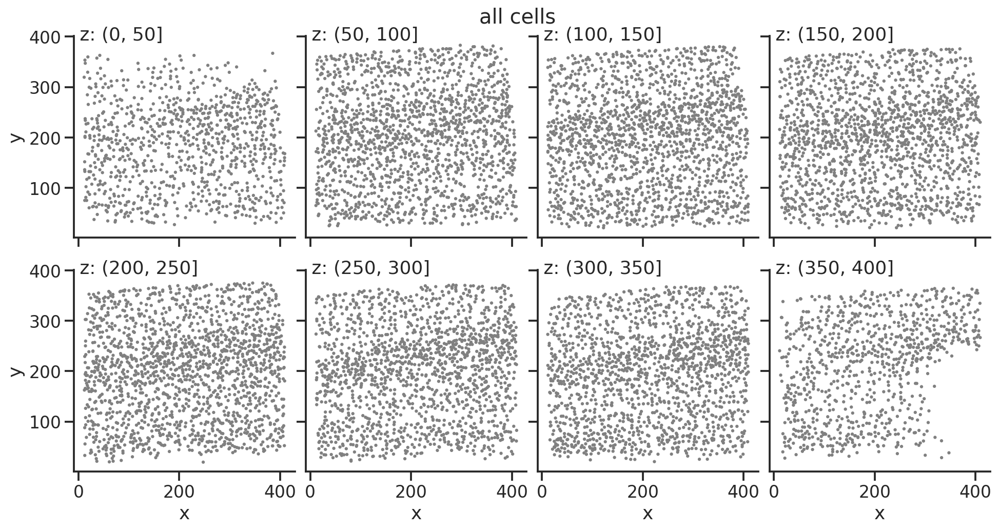

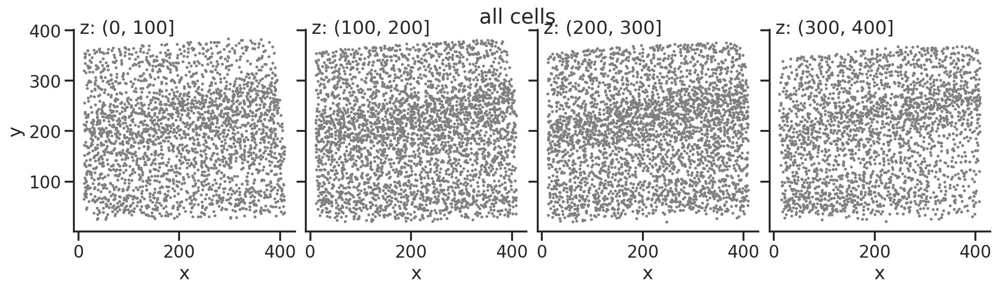

In [101]:
sp_x, sp_y = 'x', 'y'
col = None
view_z_sections(dfnew, sp_x, sp_y, col=col, title='all cells')
view_z_sections_4panels(dfnew, sp_x, sp_y, col=col, title='all cells')

/tmp/ipykernel_2365/3168467605.py:40: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  fig.colorbar(g, cax=cax, label='', shrink=0.3, aspect=10, ticks=[0,vmax], orientation='vertical')


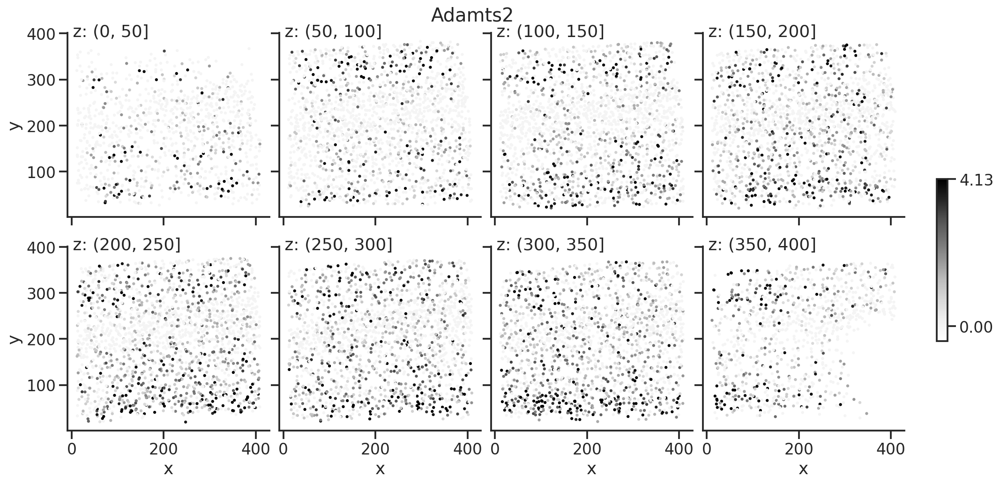

/tmp/ipykernel_2365/3274490383.py:39: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  fig.colorbar(g, cax=cax, label='', shrink=0.3, aspect=10, ticks=[0,vmax], orientation='vertical')


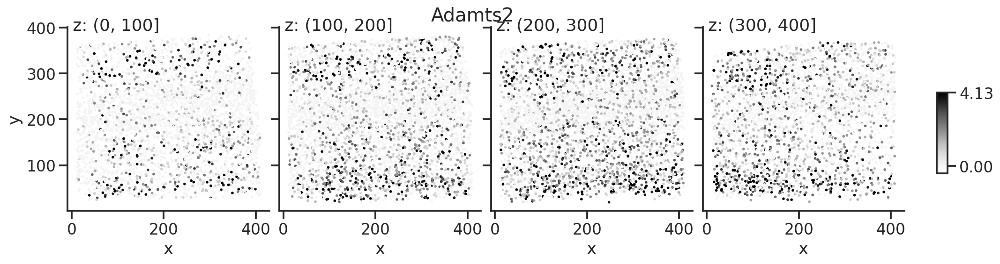

In [100]:
sp_x, sp_y = 'x', 'y'
col = ftrs_order[0]
title = gene_names[col]
view_z_sections(dfnew, sp_x, sp_y, col=col, cmap='Greys', title=title)
view_z_sections_4panels(dfnew, sp_x, sp_y, col=col, cmap='Greys', title=title)

/tmp/ipykernel_2365/3274490383.py:39: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  fig.colorbar(g, cax=cax, label='', shrink=0.3, aspect=10, ticks=[0,vmax], orientation='vertical')


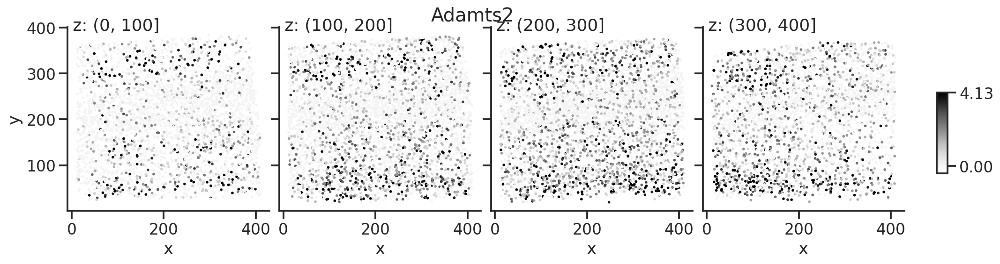

/tmp/ipykernel_2365/3274490383.py:39: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  fig.colorbar(g, cax=cax, label='', shrink=0.3, aspect=10, ticks=[0,vmax], orientation='vertical')


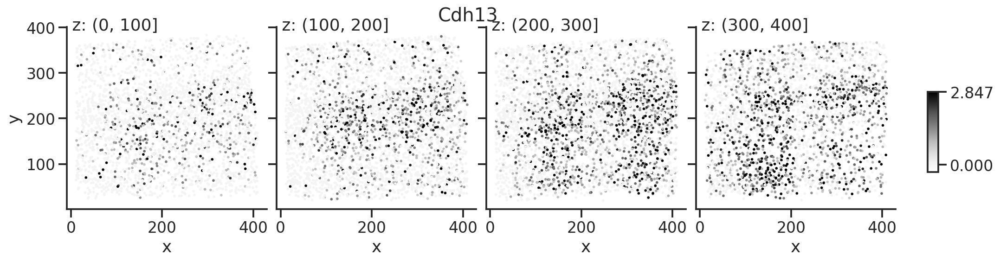

/tmp/ipykernel_2365/3274490383.py:39: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  fig.colorbar(g, cax=cax, label='', shrink=0.3, aspect=10, ticks=[0,vmax], orientation='vertical')


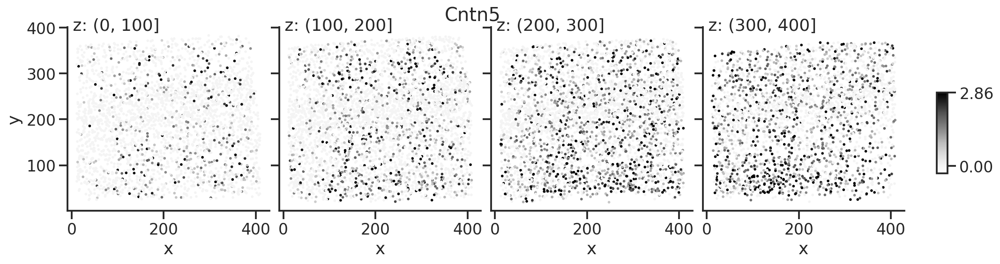

/tmp/ipykernel_2365/3274490383.py:39: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  fig.colorbar(g, cax=cax, label='', shrink=0.3, aspect=10, ticks=[0,vmax], orientation='vertical')


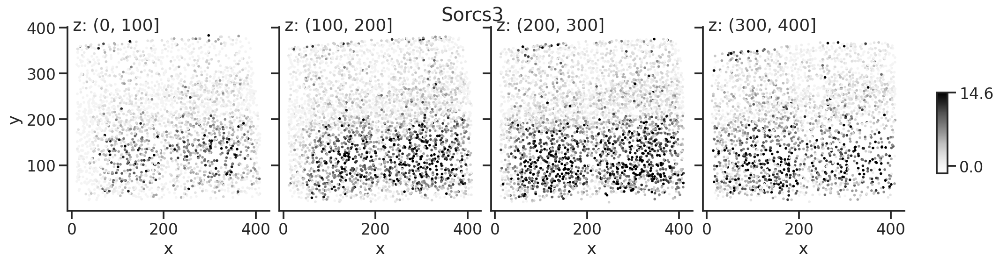

/tmp/ipykernel_2365/3274490383.py:39: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  fig.colorbar(g, cax=cax, label='', shrink=0.3, aspect=10, ticks=[0,vmax], orientation='vertical')


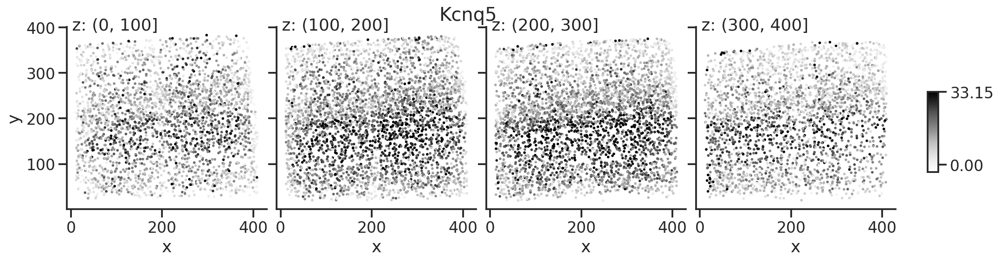

/tmp/ipykernel_2365/3274490383.py:39: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  fig.colorbar(g, cax=cax, label='', shrink=0.3, aspect=10, ticks=[0,vmax], orientation='vertical')


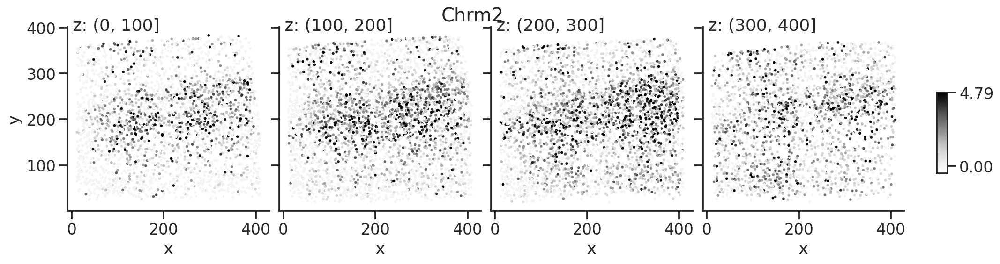

/tmp/ipykernel_2365/3274490383.py:39: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  fig.colorbar(g, cax=cax, label='', shrink=0.3, aspect=10, ticks=[0,vmax], orientation='vertical')


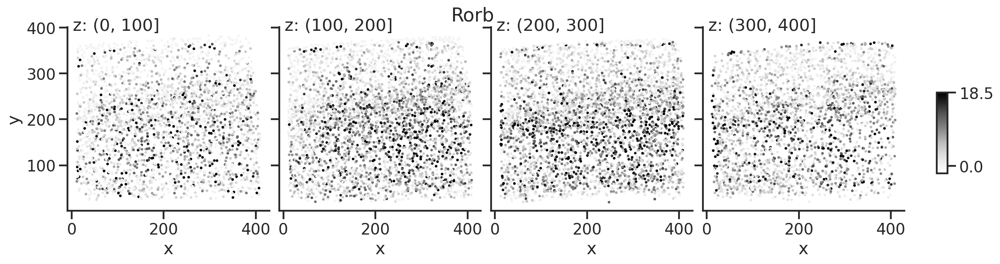

/tmp/ipykernel_2365/3274490383.py:39: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  fig.colorbar(g, cax=cax, label='', shrink=0.3, aspect=10, ticks=[0,vmax], orientation='vertical')


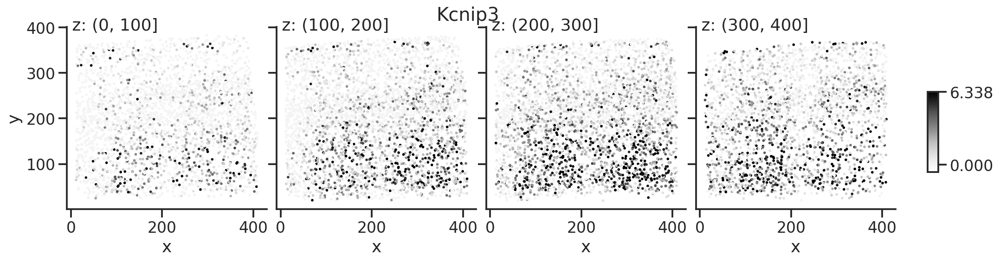

In [103]:
sp_x, sp_y = 'x', 'y'
for col in ftrs_order:
    # col = ftrs_order[0]
    title = gene_names[col]
    view_z_sections_4panels(dfnew, sp_x, sp_y, col=col, cmap='Greys', title=title)
    # view_z_sections(dfnew, sp_x, sp_y, col=col, cmap='Greys', title=title)

# view PCs

/tmp/ipykernel_50407/3893732157.py:38: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  fig.colorbar(g, cax=cax, label='', shrink=0.3, aspect=10, ticks=[vmin,vmax], orientation='vertical')


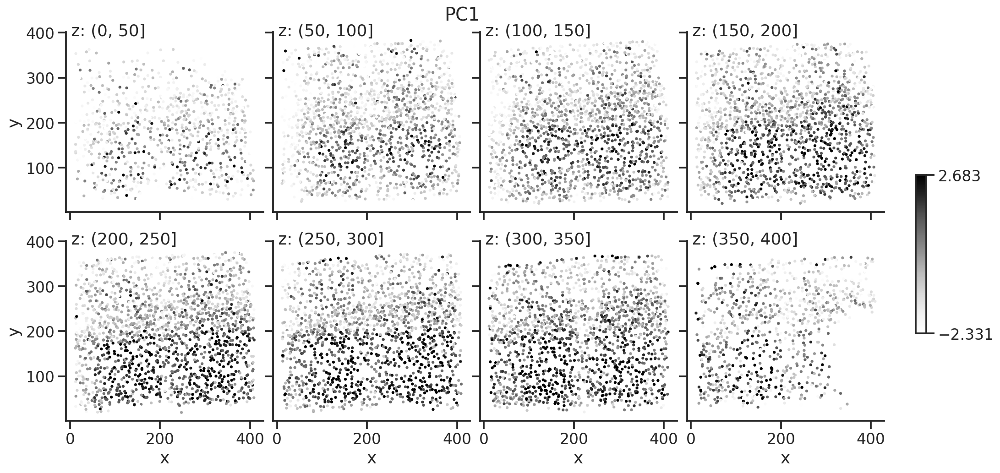

/tmp/ipykernel_50407/3893732157.py:38: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  fig.colorbar(g, cax=cax, label='', shrink=0.3, aspect=10, ticks=[vmin,vmax], orientation='vertical')


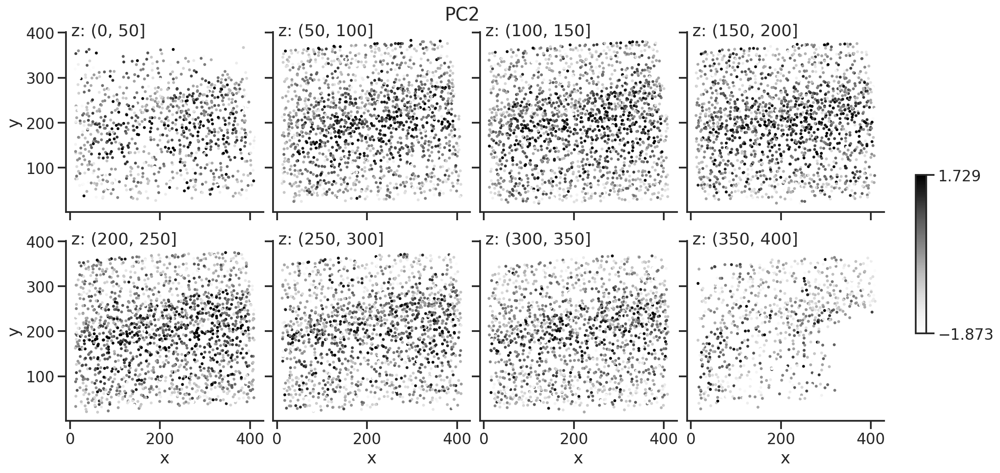

/tmp/ipykernel_50407/3893732157.py:38: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  fig.colorbar(g, cax=cax, label='', shrink=0.3, aspect=10, ticks=[vmin,vmax], orientation='vertical')


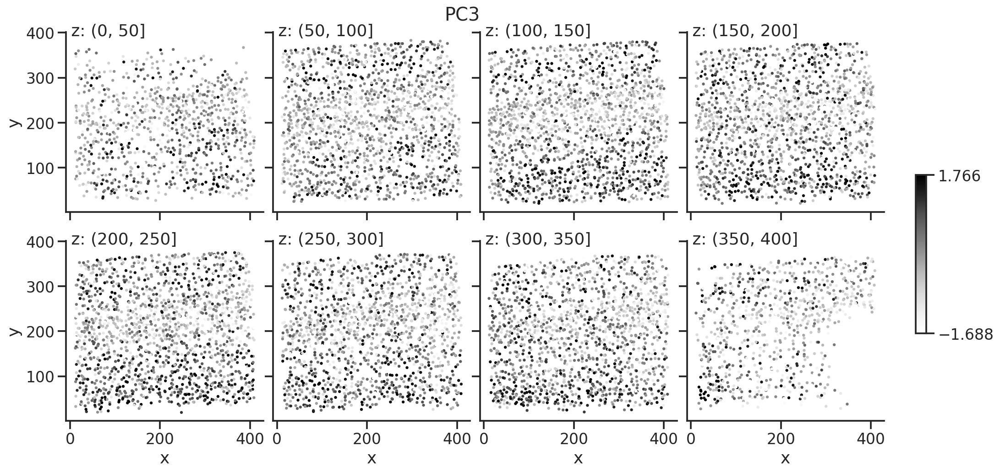

/tmp/ipykernel_50407/3893732157.py:38: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  fig.colorbar(g, cax=cax, label='', shrink=0.3, aspect=10, ticks=[vmin,vmax], orientation='vertical')


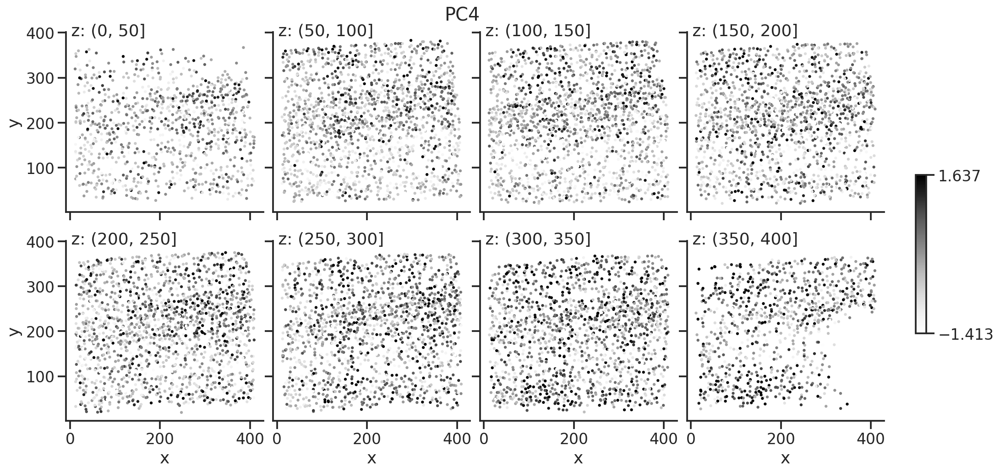

/tmp/ipykernel_50407/3893732157.py:38: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  fig.colorbar(g, cax=cax, label='', shrink=0.3, aspect=10, ticks=[vmin,vmax], orientation='vertical')


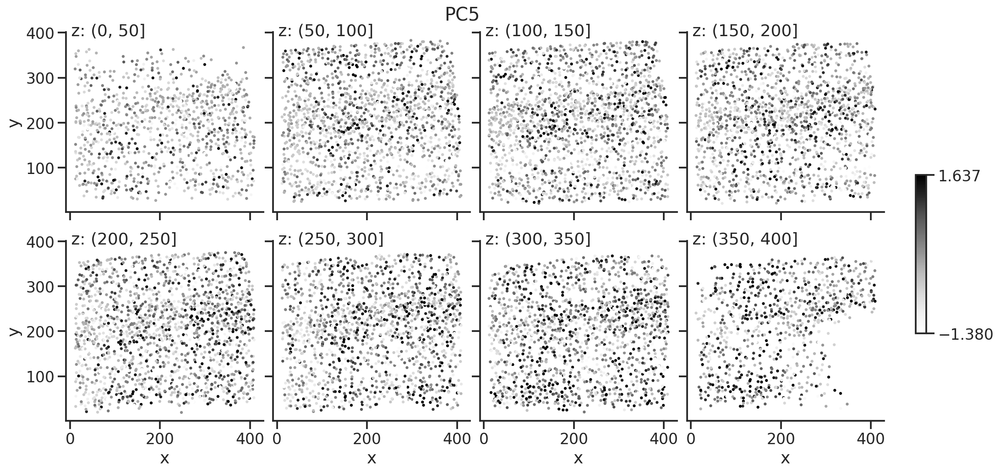

/tmp/ipykernel_50407/3893732157.py:38: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  fig.colorbar(g, cax=cax, label='', shrink=0.3, aspect=10, ticks=[vmin,vmax], orientation='vertical')


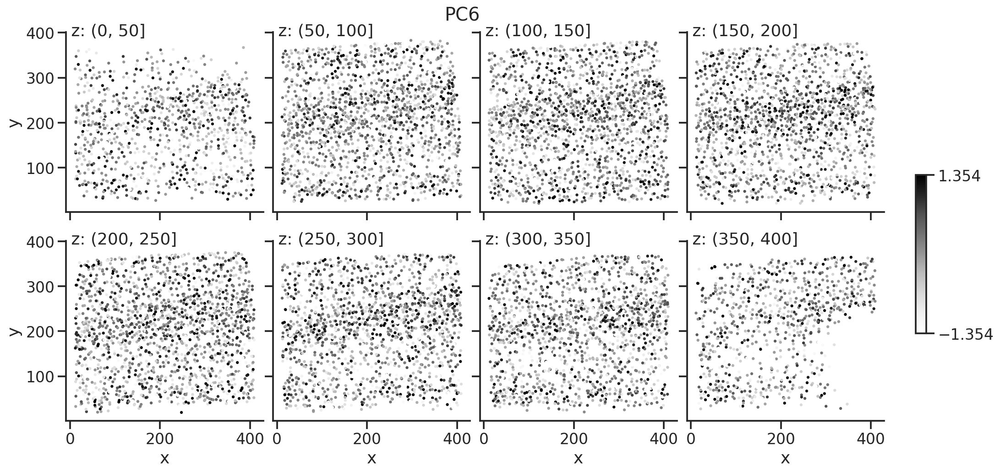

/tmp/ipykernel_50407/3893732157.py:38: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  fig.colorbar(g, cax=cax, label='', shrink=0.3, aspect=10, ticks=[vmin,vmax], orientation='vertical')


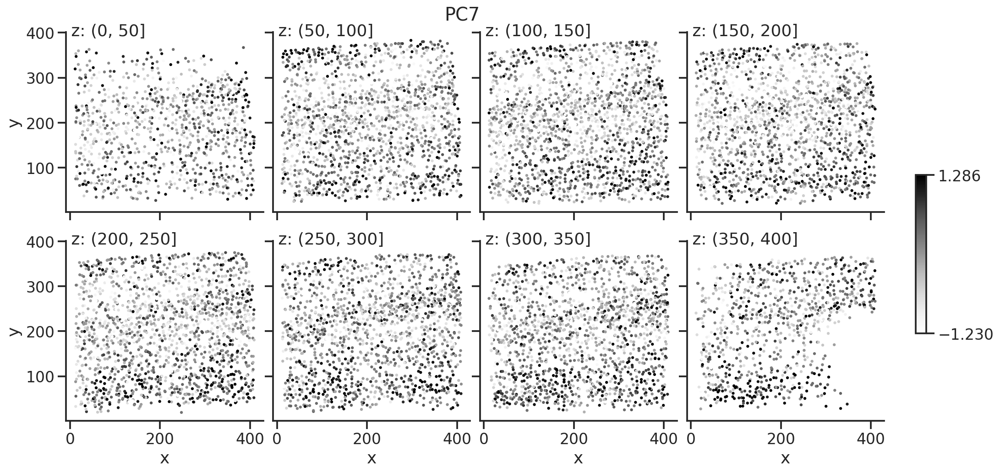

/tmp/ipykernel_50407/3893732157.py:38: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  fig.colorbar(g, cax=cax, label='', shrink=0.3, aspect=10, ticks=[vmin,vmax], orientation='vertical')


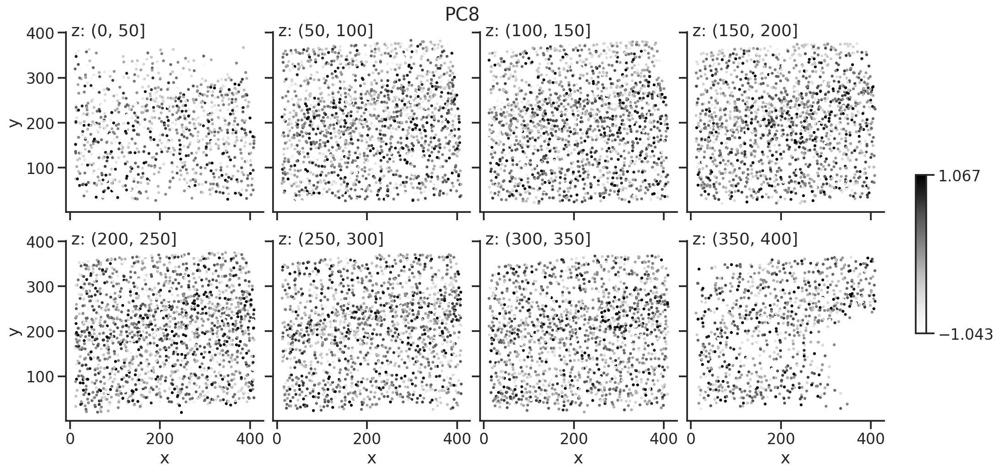

In [33]:
sp_x, sp_y = 'x', 'y'
for i in idx_pcs:
    col = f"PC{i}"
    title = col
    view_z_sections(dfnew, sp_x, sp_y, col=col, cmap='Greys', title=title, vmaxp=95, vminp=5)

# co-expression, clustering, cluster enrichment of expression

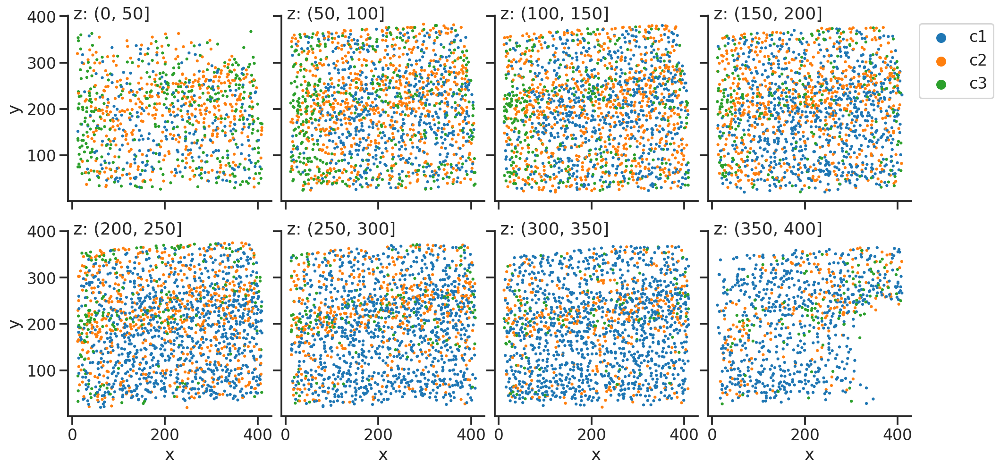

In [34]:
sp_x, sp_y = 'x', 'y'
col = 'clsts_r0.05'
view_z_sections_labels(dfnew, sp_x, sp_y, col, palette=None, title=None)

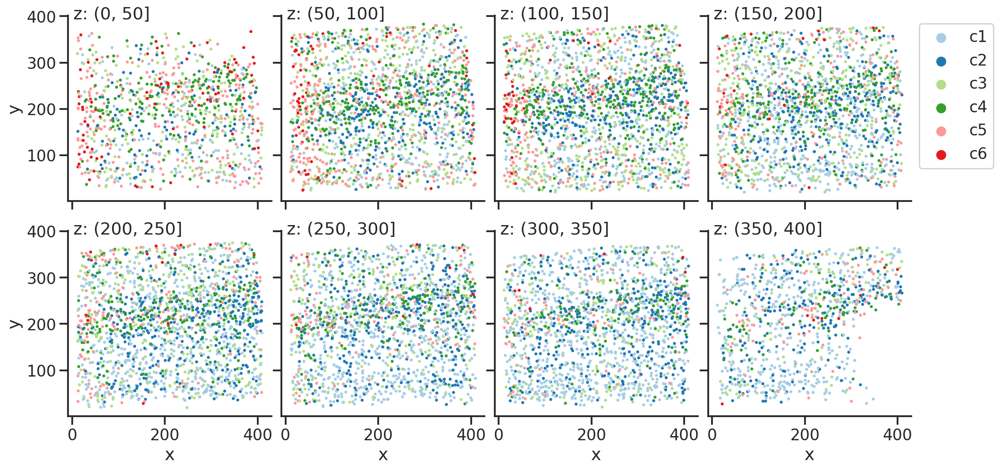

In [35]:
sp_x, sp_y = 'x', 'y'
col = 'clsts_r0.1'
view_z_sections_labels(dfnew, sp_x, sp_y, col, palette=None, title=None)

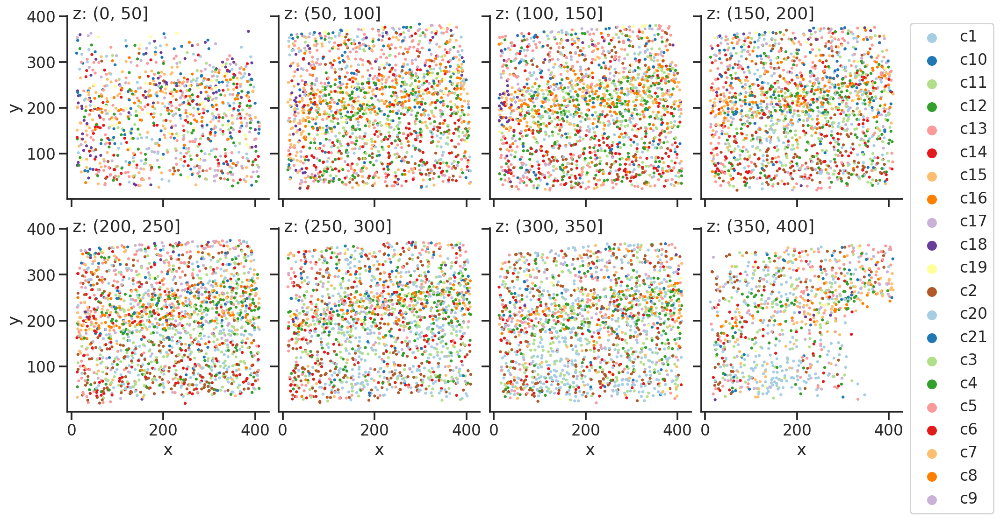

In [36]:
sp_x, sp_y = 'x', 'y'
col = 'clsts_r1'
view_z_sections_labels(dfnew, sp_x, sp_y, col, palette=None, title=None)

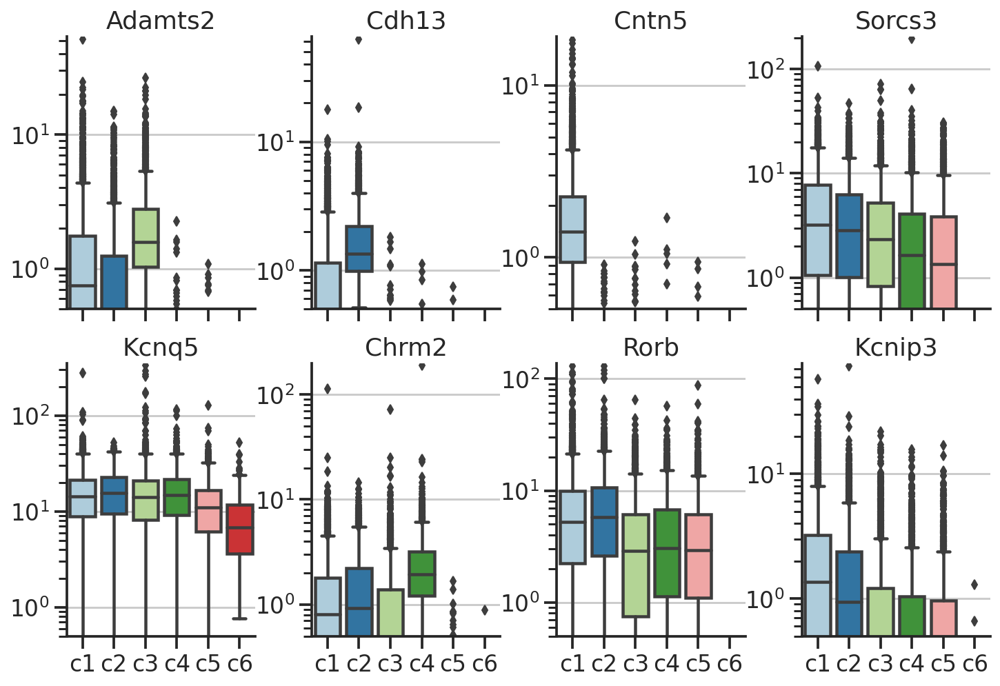

In [37]:
# col = normed_ftrs_cols[0]
# col = ftrs_cols[0]

group = 'clsts_r0.1'
palette = gen_palette(dfnew, group)

fig, axs = plt.subplots(2,4,figsize=(3*4,4*2), sharex=True)
grouporder = np.unique(dfnew[group])
for i, col in enumerate(ftrs_order):
    ax = axs.flat[i]
    # col = ftrs_order[0]

    sns.boxplot(data=dfnew, x=group, order=grouporder, palette=palette, y=col, ax=ax,)
    sns.despine(ax=ax)
    ax.set_ylim(ymin=0.5)
    ax.set_title(gene_names[col])
    ax.set_ylabel("") #gene_names[col])
    ax.set_xlabel("") #gene_names[col])
    ax.set_yscale('log')
fig.subplots_adjust(wspace=0.3)

<AxesSubplot:ylabel='clsts_r0.1'>

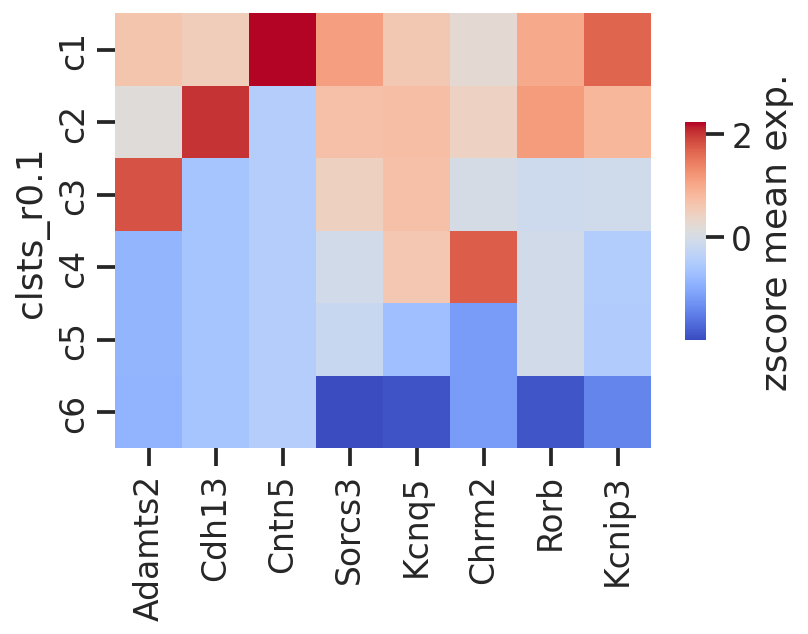

In [38]:
group = 'clsts_r0.1'
dfmean = dfnew.groupby(group)[ftrs_order].mean()
dfmean = basicu.zscore(dfmean, axis=0)

fig, ax = plt.subplots(figsize=(6,4))
sns.heatmap(dfmean, ax=ax, 
            xticklabels=[gene_names[col] for col in dfmean.columns],
            cmap='coolwarm', cbar_kws=dict(label='zscore mean exp.', shrink=0.5, aspect=10))

<AxesSubplot:ylabel='clsts_r0.1'>

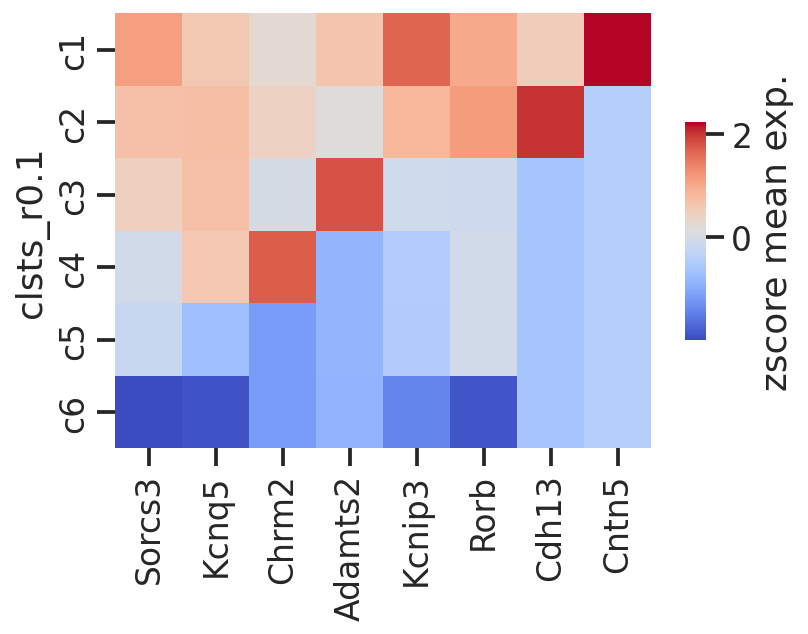

In [39]:
group = 'clsts_r0.1'
dfmean = dfnew.groupby(group)[ftrs_cols].mean()
dfmean = basicu.zscore(dfmean, axis=0)

fig, ax = plt.subplots(figsize=(6,4))
sns.heatmap(dfmean, ax=ax, 
            xticklabels=[gene_names[col] for col in dfmean.columns],
            cmap='coolwarm', cbar_kws=dict(label='zscore mean exp.', shrink=0.5, aspect=10))